In [31]:
using MySQL
using DataFrames
using Dates
using TimeZones
using Plots
using Plots.PlotMeasures
using StatsBase, LinearAlgebra
using LaTeXStrings
using JSON
using StatsBase
using CSV

import Base: @kwdef

In [32]:
timestamp(t; target_tz::VariableTimeZone=tz"America/Los_Angeles") = astimezone(
    ZonedDateTime(Dates.unix2datetime(t), tz"GMT"), target_tz
)

timestamp (generic function with 1 method)

In [33]:
timestamp(1644073787.255261)

2022-02-05T07:09:47.255-08:00

In [34]:
function get_emeter_data(conn::MySQL.Connection, name::String, idx::Int64)
    DBInterface.execute(
        DBInterface.prepare(conn,
            "SET @v1 := (SELECT emeter_start FROM $(name) WHERE idx = $(idx))"
        )
    )
    DBInterface.execute(
        DBInterface.prepare(conn,
            "SET @v2 := (SELECT emeter_end FROM $(name) WHERE idx = $(idx))"
        )
    )
    events = DBInterface.execute(
        DBInterface.prepare(conn,
            "SELECT * FROM $(name)_emeter WHERE idx BETWEEN @v1 and @v2"
        )
    ) |> DataFrame
    events = transform(
        events,
        :t => (x->timestamp.(x)) => :timestamp
    )
    return events
end

@kwdef mutable struct DBCredentials
    host::String
    name::String
    username::String
    password::String
end

DBCredentials

In [35]:
db_credenitals = DBCredentials(
    ;JSON.parsefile(
        joinpath("..", "..", "coffee-secrets", "db.json"),
        dicttype=Dict{Symbol,String}
    )...
)
db_credenitals.host = "127.0.0.1";

In [36]:
db_conn = DBInterface.connect(
    MySQL.Connection, db_credenitals.host,
    db_credenitals.username, db_credenitals.password,
    db=db_credenitals.name
)

MySQL.Connection(host="127.0.0.1", user="coffee", port="3306", db="coffee")

In [37]:
name = "Arstotzka_Ministry_of_Energy"
idx_max = 54
idx_blacklist = [
    1,2,3,4,5,6,7,8,9,  # Debugging
    51  #  Battery Charger
]

all_emeter_data = DataFrame[]

for idx=1:idx_max
    if idx in idx_blacklist
        continue
    end
    push!(all_emeter_data, get_emeter_data(db_conn, name, idx))
end
all_emeter_data = vcat(all_emeter_data...)

,idx,t,ma,mv,mw,wh,timestamp
,Int32,Float64?,Int32?,Int32?,Int32?,Int32?,ZonedDat…
1,12,1.64349e9,59,121266,7139,7512,2022-01-29T12:19:41.336-08:00
2,13,1.64349e9,59,121266,7139,7512,2022-01-29T12:20:45.166-08:00
3,14,1.64349e9,59,121266,7139,7512,2022-01-29T12:20:53.324-08:00
4,15,1.64349e9,59,121266,7139,7512,2022-01-29T12:20:54.646-08:00
5,16,1.64349e9,59,121266,7139,7512,2022-01-29T12:20:55.542-08:00
6,17,1.64349e9,59,121266,7139,7512,2022-01-29T12:20:56.556-08:00
7,18,1.64349e9,59,121266,7139,7512,2022-01-29T12:21:03.581-08:00
8,19,1.64349e9,59,121266,7139,7512,2022-01-29T12:21:16.887-08:00
9,20,1.64349e9,59,121266,7139,7512,2022-01-29T12:21:20.293-08:00


In [38]:
all_emeter_data[end,:]

,idx,t,ma,mv,mw,wh,timestamp
,Int32,Float64?,Int32?,Int32?,Int32?,Int32?,ZonedDat…
1549064,1557423,1.64547e9,1601,119674,172175,23295,2022-02-21T11:45:00.696-08:00


In [39]:
data = @view all_emeter_data[end-Int(2e5):end, :];

In [40]:
plot(data[!, :ma])

In [41]:
plot(data[:, :mv])

In [42]:
plot(data[:, :wh])

In [13]:
idx = 53
emeter_data = get_emeter_data(db_conn, name, idx)

data = @view emeter_data[end-Int(1e5):end, :]
plot(data[!, :ma].* data[!, :mv] ./ 1000)
plot!(data[!, :mw])

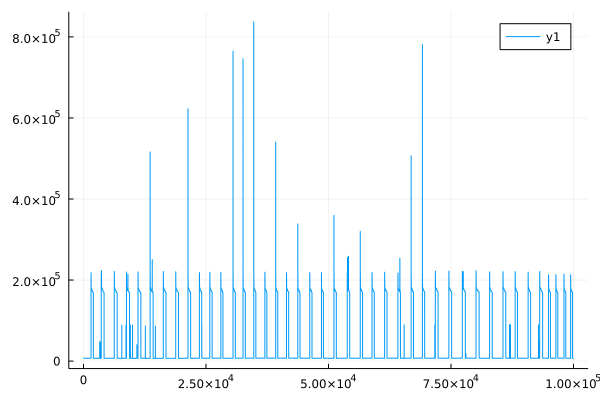

In [14]:
plot(data[!, :mw])

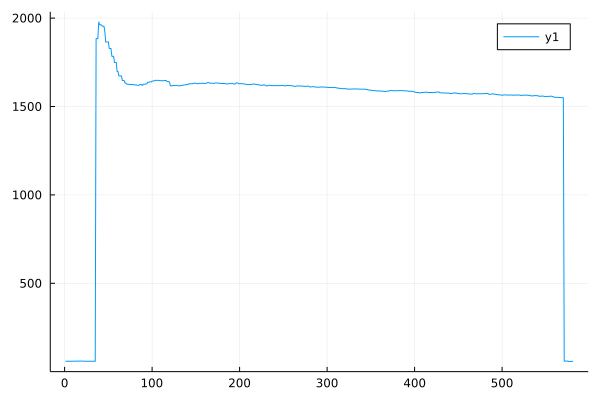

In [15]:
peak1 = @view emeter_data[920:1500, :]
plot(peak1[!, :ma])

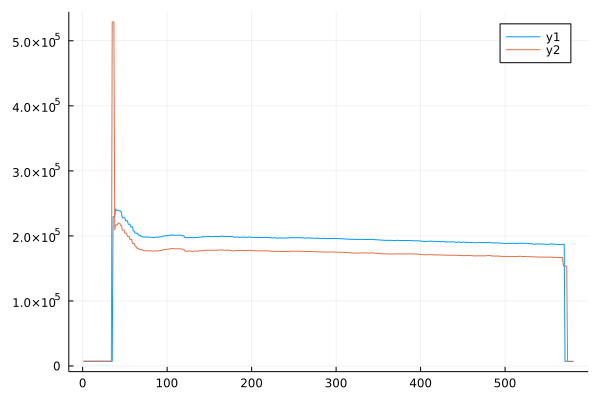

In [16]:
plot(peak1[!, :ma] .* peak1[!, :mv] ./ 1000)
plot!(peak1[!, :mw])

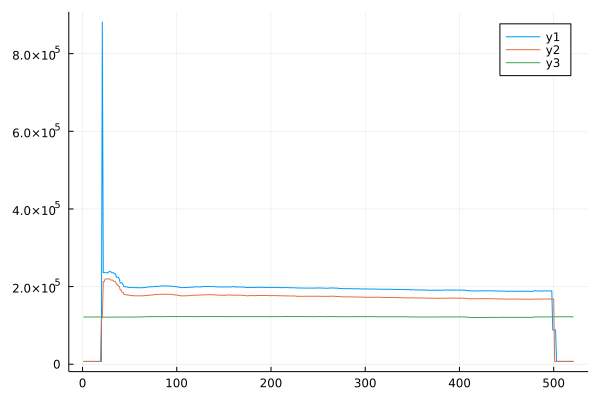

In [17]:
peak2 = @view emeter_data[3900:4420, :]
plot(peak2[!, :ma] .* peak2[!, :mv] ./ 1000)
plot!(peak2[!, :mw])
plot!(peak2[!, :mv])

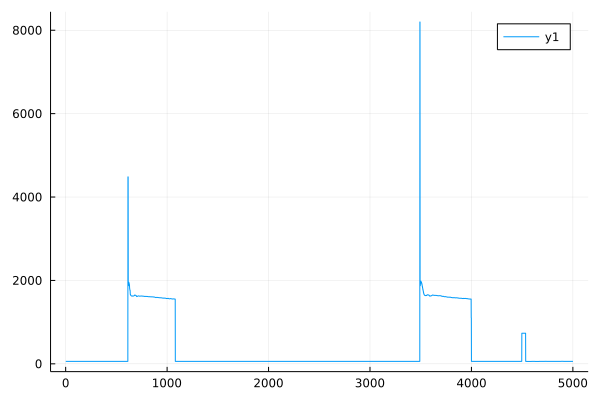

In [18]:
plot(emeter_data[6000:11000, :ma])

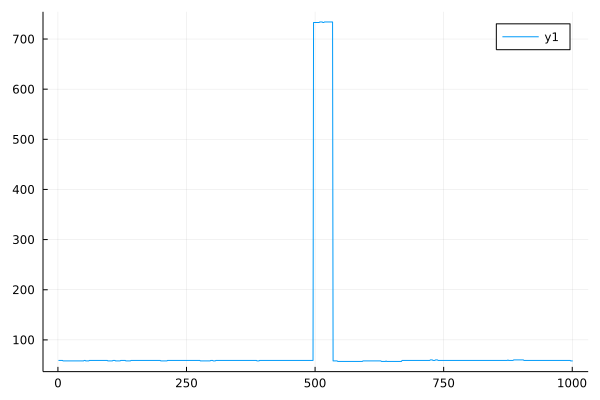

In [19]:
plot(emeter_data[10000:11000, :ma])

In [20]:
t = @view all_emeter_data[!, :ma]
h = fit(Histogram, t, 1:1:maximum(t))
# h = normalize(h, mode=:density)

Histogram{Int64, 1, Tuple{StepRange{Int64, Int64}}}
edges:
  1:1:9012
weights: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
closed: left
isdensity: false

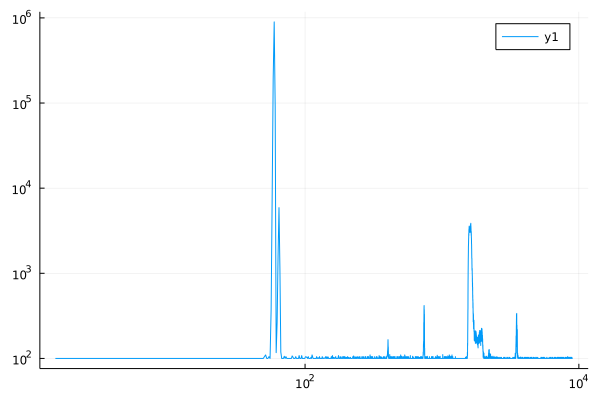

In [21]:
e = collect(h.edges[1])
x = e[1:end-1] + diff(e)/2
y = h.weights
plot(x, y.+100, xaxis=:log, yaxis=:log)

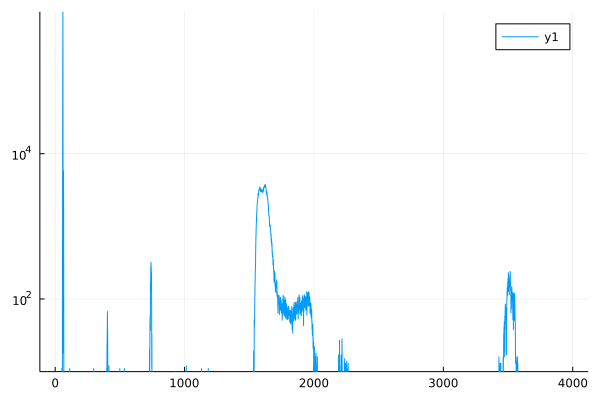

In [22]:
plot(x[x.<4000], y[x.<4000] .+ 1, yaxis=:log)
ylims!(10, maximum(y)+100)

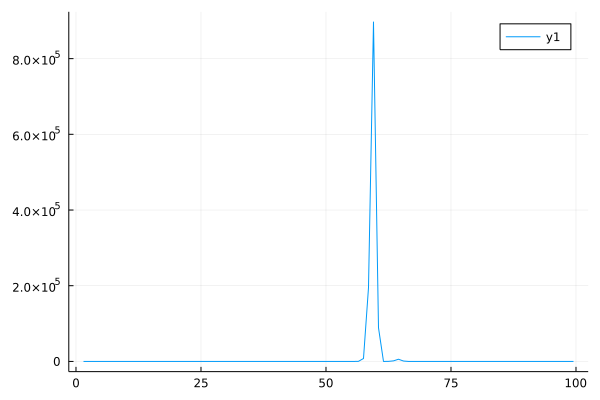

In [23]:
plot(x[x.<100], y[x.<100])

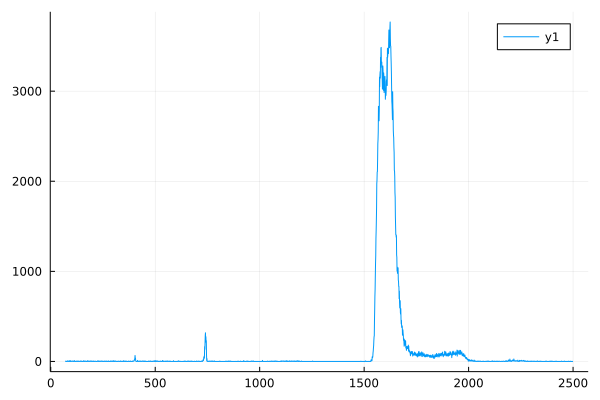

In [24]:
plot(x[x.>70 .&& x.<2500], y[x.>70 .&& x.<2500])

In [25]:
rising(x, i; th) = (x[i-1] <= th) && (x[i] > th)
falling(x, i; th) = (x[i] >= th) && (x[i+1] < th)

function excursion(x; th)
    e = Int64[]
    for i in 2:(lastindex(x)-1)
        if rising(x, i; th=th) && falling(x, i; th=th)
            push!(e, i)
        end
    end
    return e
end

function patch_excursions!(x; th)
    e = excursion(x; th=th);
    for i in 2:(lastindex(x)-1)
        if x[i] in e
            x[i] = (x[i-1] + x[i+1])/2
        end
    end
end

function edge(x, start, fn; th, min)
    for i in start:(lastindex(x)-1)
        if fn(x, i; th=th) && i-start >= min
            return i
        end
    end
    return lastindex(x)
end

function peaks(x; th, min)
    p = Pair[]
    i = 2
    while i<(lastindex(x)-1)
        r = edge(x, i, rising; th=th, min=min)
        f = edge(x, r, falling; th=th, min=min)
        push!(p, Pair(r, f))
        if i == f
            i = f + 1
        else
            i = f
        end
    end
    return p
end

peaks (generic function with 1 method)

In [26]:
patch_excursions!(t; th=80)
p = peaks(t; th=80, min=0)

868-element Vector{Pair}:
     942 => 1454
    1694 => 1721
    2478 => 2559
    2739 => 2743
    3206 => 3748
    6353 => 6359
    6423 => 6565
    7168 => 7175
    7340 => 7489
    8572 => 9046
   11065 => 11536
   13554 => 14023
   16123 => 16609
         ⋮
 1528056 => 1528534
 1530948 => 1531423
 1534101 => 1534646
 1537340 => 1537822
 1539968 => 1540446
 1541113 => 1541132
 1541760 => 1541768
 1542559 => 1542563
 1542584 => 1542587
 1543061 => 1543490
 1546213 => 1546713
 1548798 => 1548881

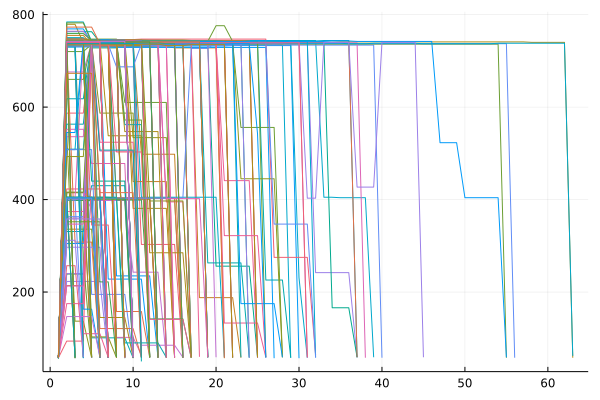

In [27]:
plt = plot(legend=false)
for e in p[1:end-1]
    if mean(@view t[e.first:e.second]) < 1000
        plot!(t[e.first-1:e.second+1])
    end
end
plt

In [28]:
plt = plot(legend=false)
for e in p[1:end-1]
    if mean(@view t[e.first:e.second]) > 1000
        plot!(t[e.first-1:e.second+1])
    end
end
plt

In [29]:
t = @view all_emeter_data[!, :mv]
h = fit(Histogram, t, 1:1:maximum(t))
h = normalize(h, mode=:density)

Histogram{Float64, 1, Tuple{StepRange{Int64, Int64}}}
edges:
  1:1:123810
weights: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0  …  0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
closed: left
isdensity: true

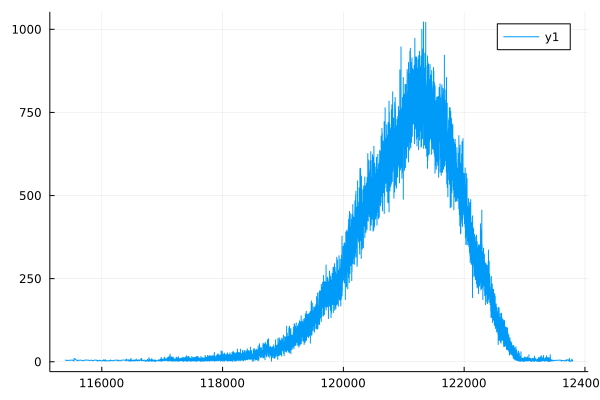

In [30]:
e = collect(h.edges[1])
x = e[1:end-1] + diff(e)/2
y = h.weights
plot(x[y.>0], y[y.>0])